In [1]:
import pandas as pd
import numpy as np
import os #Interacts with the operating system, e.g. paths, mkdir
import seaborn as sns
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D # Allows ploting in a 3D graph

from sklearn.preprocessing import StandardScaler,LabelEncoder
from sklearn.cluster import KMeans
from sklearn.metrics import confusion_matrix,classification_report

from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split


In [2]:
file_path = r'C:/Users/crist/Documents/02.MSU_MsDataScience/2024.SPRING/04.CSIT598_03SP24_MACHINE-LEARNING/02.MACHINE_LEARNING_SP23/PowerPlantsintheU_Export_TableToExcel.xlsx'
df = pd.read_excel(file_path)

In [3]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report

# Assuming 'Primary Source' column contains the type of power plant
X1 = df[['Install_MW', 'Bat_MW','Bio_MW','Coal_MW','Geo_MW','Hydro_MW', 'HydroPS_MW', 'NG_MW', 'Nuclear_MW', 'Crude_MW', 'Solar_MW', 'Wind_MW', 'Other_MW']]  # example features
y1 = df['PrimSource']  # target

# Split the data into training and testing sets
X1_train, X1_test, y1_train, y1_test = train_test_split(X1, y1, test_size=0.2, random_state=43)

# Initialize and train the classifier
classifier = RandomForestClassifier(random_state=43)
classifier.fit(X1_train, y1_train)

# Make predictions and evaluate the model
y1_pred = classifier.predict(X1_test)
print(classification_report(y1_test, y1_pred))

                precision    recall  f1-score   support

     batteries       1.00      0.98      0.99        49
       biomass       1.00      0.99      1.00       101
          coal       0.94      0.96      0.95        47
    geothermal       1.00      1.00      1.00        12
 hydroelectric       0.99      0.99      0.99       265
   natural gas       0.98      1.00      0.99       405
       nuclear       1.00      0.92      0.96        13
         other       1.00      0.94      0.97        18
     petroleum       0.99      0.97      0.98       178
pumped storage       0.86      1.00      0.92         6
         solar       1.00      1.00      1.00      1041
          wind       1.00      1.00      1.00       267

      accuracy                           0.99      2402
     macro avg       0.98      0.98      0.98      2402
  weighted avg       0.99      0.99      0.99      2402



In [4]:
# Select columns to analyze
Scolumns = ['State','PrimSource','Install_MW','Total_MW','Bat_MW','Bio_MW','Coal_MW','Geo_MW','Hydro_MW', 'HydroPS_MW', 'NG_MW', 'Nuclear_MW', 'Crude_MW', 'Solar_MW', 'Wind_MW', 'Other_MW','Longitude','Latitude']

# One-hot encoding
data_encoded = df[['Latitude','Longitude','State','Install_MW', 'Bat_MW','Bio_MW','Coal_MW','Geo_MW','Hydro_MW', 'HydroPS_MW', 'NG_MW', 'Nuclear_MW', 'Crude_MW', 'Solar_MW', 'Wind_MW', 'Other_MW']]  # example features
# pd.get_dummies(df[Scolumns], columns = ['State',], dtype='int')

data_encoded.head()
                              

,Latitude,Longitude,State,Install_MW,Bat_MW,Bio_MW,Coal_MW,Geo_MW,Hydro_MW,HydroPS_MW,NG_MW,Nuclear_MW,Crude_MW,Solar_MW,Wind_MW,Other_MW
0,45.1786,-89.6850,Wisconsin,2.3,0.0,0.0,0.0,0.0,2.3,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,45.1136,-87.7586,Wisconsin,1.3,0.0,0.0,0.0,0.0,1.3,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,44.5400,-88.0086,Wisconsin,91.0,0.0,0.0,0.0,0.0,0.0,0.0,79.0,0.0,0.0,0.0,0.0,0.0
3,45.2333,-88.0678,Wisconsin,3.8,0.0,0.0,0.0,0.0,3.8,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,45.4411,-89.7306,Wisconsin,2.6,0.0,0.0,0.0,0.0,2.6,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [5]:
X = data_encoded.drop('State',axis=1)
y = data_encoded['State']
print("Shape of features (X):", X.shape)
print("Shape of target variable (y):", y.shape)

Shape of features (X): (12008, 15)
Shape of target variable (y): (12008,)


## Scale the data

In [6]:
scaler = MinMaxScaler()

# Fit the scaler to your training data and transform the features
X_scaled = scaler.fit_transform(X)

# Decision Trees

In [19]:
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, classification_report

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42)

# Initialize the Decision Tree Classifier
decision_tree = DecisionTreeClassifier(random_state=42)

# Train the model
decision_tree.fit(X_train, y_train)

# Make predictions
y_pred_dt = decision_tree.predict(X_test)

# Evaluate the model
accuracy_dt = accuracy_score(y_test, y_pred_dt)
print("Decision Tree Accuracy:", accuracy_dt)

# Classification report
print("Classification Report:")
print(classification_report(y_test, y_pred_dt))

# Perform n-fold cross-validation
cv_scores = cross_val_score(decision_tree, X_scaled, y, cv=13)  # Change cv value as needed

# Print the cross-validation scores
print("Cross-Validation Scores:", cv_scores)
print("Mean CV Accuracy:", cv_scores.mean())


Decision Tree Accuracy: 0.9637801831806828
Classification Report:
                      precision    recall  f1-score   support

             Alabama       0.88      0.88      0.88        17
              Alaska       1.00      1.00      1.00        24
             Arizona       1.00      0.95      0.97        41
            Arkansas       0.83      1.00      0.91        10
          California       0.99      0.99      0.99       356
            Colorado       1.00      1.00      1.00        59
         Connecticut       1.00      0.97      0.98        32
            Delaware       0.90      0.90      0.90        10
District of Columbia       0.75      1.00      0.86         3
             Florida       0.98      1.00      0.99        51
             Georgia       0.85      0.93      0.89        44
              Hawaii       1.00      1.00      1.00        13
               Idaho       0.94      1.00      0.97        30
            Illinois       0.96      0.99      0.97        67
   

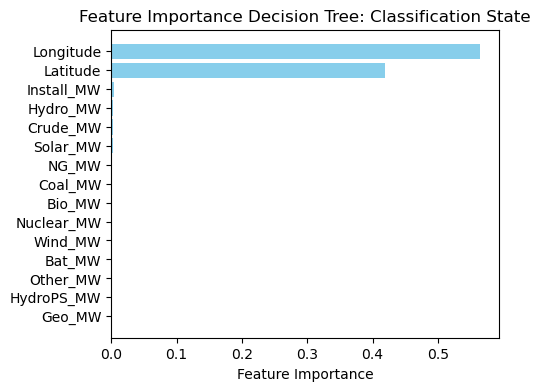

In [59]:
# Access feature importance
feature_importance = decision_tree.feature_importances_

feature_names = X.columns

# Sort feature importance and feature names together
sorted_indices = np.argsort(feature_importance)[::-1]
sorted_importance = feature_importance[sorted_indices]
sorted_names = [feature_names[i] for i in sorted_indices]

# Plotting
plt.figure(figsize=(5, 4))
plt.barh(range(len(sorted_names)), sorted_importance, align='center', color='skyblue')
plt.yticks(range(len(sorted_names)), sorted_names)
plt.xlabel('Feature Importance')
title = 'Feature Importance Decision Tree: Classification ' + y.name
plt.title(title)
plt.gca().invert_yaxis()  # Invert y-axis to display the most important feature at the top
plt.savefig(title +'.png')
plt.show()

# Random Forest

In [60]:
from sklearn.ensemble import RandomForestClassifier

# Initialize the Random Forest Classifier
random_forest = RandomForestClassifier(random_state=42)

# Train the model
random_forest.fit(X_train, y_train)

# Make predictions
y_pred_rf = random_forest.predict(X_test)

# Evaluate the model
accuracy_rf = accuracy_score(y_test, y_pred_rf)
print(f"Random Forest Accuracy {y.name}:", accuracy_rf)

# Classification report
print("Classification Report:")
print(classification_report(y_test, y_pred_rf))


# Perform n-fold cross-validation
cv_scores = cross_val_score(random_forest, X_scaled, y, cv=13)  # Change cv value as needed

# Print the cross-validation scores
print("Cross-Validation Scores:", cv_scores)
print("Mean CV Accuracy:", cv_scores.mean())

Random Forest Accuracy State: 0.9196502914238135
Classification Report:
                      precision    recall  f1-score   support

             Alabama       0.73      0.65      0.69        17
              Alaska       1.00      1.00      1.00        24
             Arizona       0.95      0.90      0.93        41
            Arkansas       0.75      0.30      0.43        10
          California       0.98      1.00      0.99       356
            Colorado       0.86      0.95      0.90        59
         Connecticut       0.89      0.78      0.83        32
            Delaware       1.00      0.40      0.57        10
District of Columbia       1.00      0.33      0.50         3
             Florida       1.00      0.98      0.99        51
             Georgia       0.85      0.93      0.89        44
              Hawaii       1.00      1.00      1.00        13
               Idaho       0.90      0.90      0.90        30
            Illinois       0.85      0.96      0.90        

### Fit the Random Forest Model

In [21]:
from sklearn.ensemble import RandomForestClassifier

# Instantiate the Random Forest Classifier
rf = RandomForestClassifier(n_estimators=100, random_state=42)

# Fit the model to your training data
rf.fit(X_train, y_train)


RandomForestClassifier(random_state=42)

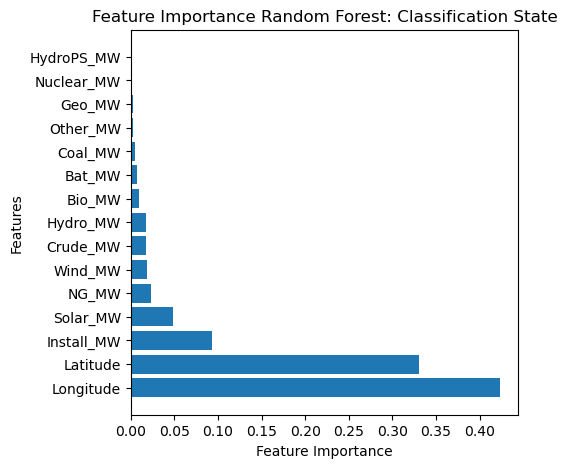

In [62]:
# Access feature importance
feature_importance = rf.feature_importances_

# Sort feature importance in descending order
sorted_indices = np.argsort(feature_importance)[::-1]
sorted_feature_importance = feature_importance[sorted_indices]
sorted_feature_names = X.columns[sorted_indices]

# Plot feature importance
plt.figure(figsize=(5, 5))
plt.barh(range(len(sorted_feature_importance)), sorted_feature_importance, align='center')
plt.yticks(range(len(sorted_feature_importance)), sorted_feature_names)
plt.xlabel('Feature Importance')
plt.ylabel('Features')
title = 'Feature Importance Random Forest: Classification ' + y.name
plt.title(title)
plt.show()


### Permutation Importance

In [12]:
X

,Latitude,Longitude,Install_MW,Bat_MW,Bio_MW,Coal_MW,Geo_MW,Hydro_MW,HydroPS_MW,NG_MW,Nuclear_MW,Crude_MW,Solar_MW,Wind_MW,Other_MW
0,45.178600,-89.685000,2.3,0.0,0.0,0.0,0.0,2.3,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,45.113600,-87.758600,1.3,0.0,0.0,0.0,0.0,1.3,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,44.540000,-88.008600,91.0,0.0,0.0,0.0,0.0,0.0,0.0,79.0,0.0,0.0,0.0,0.0,0.0
3,45.233300,-88.067800,3.8,0.0,0.0,0.0,0.0,3.8,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,45.441100,-89.730600,2.6,0.0,0.0,0.0,0.0,2.6,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12003,35.380139,-82.375953,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0
12004,36.009321,-79.367698,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0
12005,35.273434,-79.736312,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0,0.0,0.0
12006,42.876570,-73.910480,1.4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.4,0.0,0.0


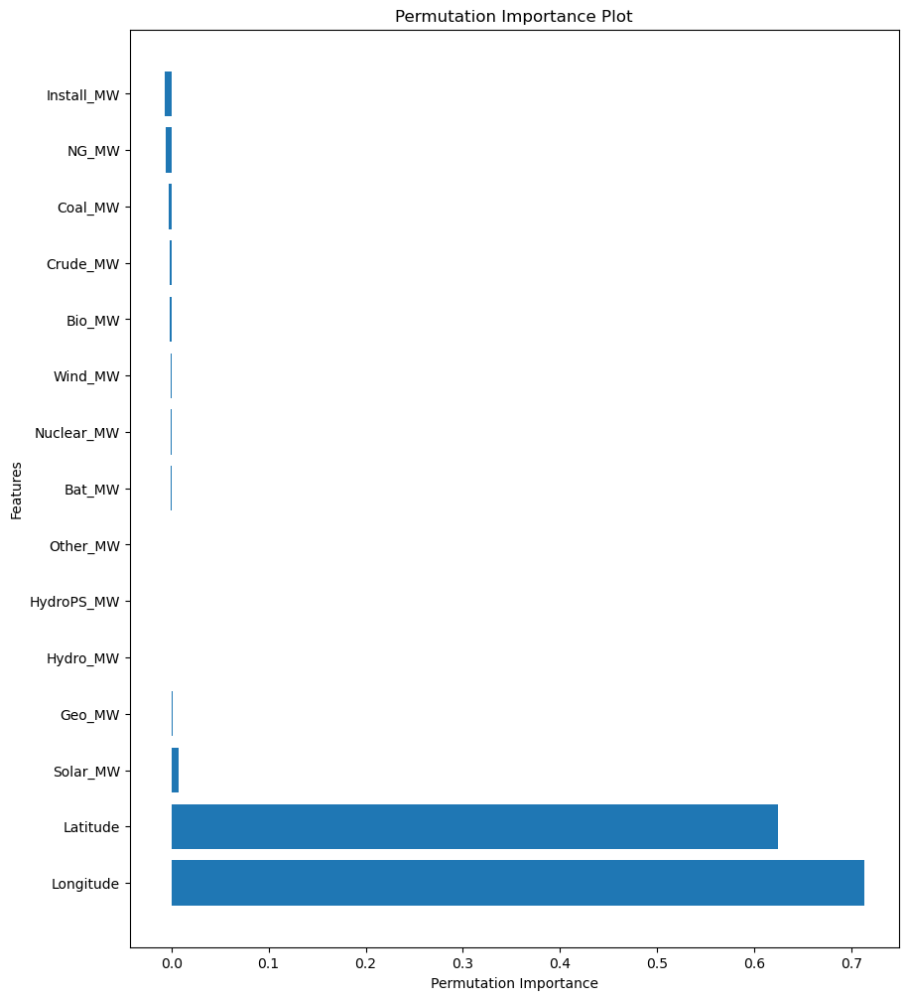

In [13]:
from sklearn.inspection import permutation_importance

# Compute permutation importance
perm_importance = permutation_importance(rf, X_test, y_test)
sorted_indices = np.argsort(perm_importance.importances_mean)[::-1]

# Plot permutation importance
plt.figure(figsize=(10, 12))
plt.barh(range(len(sorted_indices)), perm_importance.importances_mean[sorted_indices], align='center')
plt.yticks(range(len(sorted_indices)), X.columns[sorted_indices])
plt.xlabel('Permutation Importance')
plt.ylabel('Features')
plt.title('Permutation Importance Plot')
plt.show()


### Partial Dependence Plots

In [23]:
pip install treeinterpreter

Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 23.3.1 -> 24.0
[notice] To update, run: python.exe -m pip install --upgrade pip


In [24]:
from treeinterpreter import treeinterpreter as ti

prediction, bias, contributions = ti.predict(rf, X_train)

In [25]:
# Print predictions, bias, and contributions
print("Predictions:", prediction)
print("Bias:", bias)
print("Contributions:")
for i in range(len(contributions)):
    print("Instance", i+1, ":", contributions[i])

Predictions: [[0.   0.   0.   ... 0.   0.   0.  ]
 [0.   0.   0.   ... 0.   0.02 0.  ]
 [0.   0.   0.   ... 0.   0.   0.  ]
 ...
 [0.   0.   0.76 ... 0.   0.   0.  ]
 [0.   0.01 0.   ... 0.   0.   0.  ]
 [0.   0.   0.01 ... 0.   0.   0.  ]]
Bias: [[0.00631793 0.01311472 0.0114366  ... 0.00318759 0.01671247 0.00529877]
 [0.00631793 0.01311472 0.0114366  ... 0.00318759 0.01671247 0.00529877]
 [0.00631793 0.01311472 0.0114366  ... 0.00318759 0.01671247 0.00529877]
 ...
 [0.00631793 0.01311472 0.0114366  ... 0.00318759 0.01671247 0.00529877]
 [0.00631793 0.01311472 0.0114366  ... 0.00318759 0.01671247 0.00529877]
 [0.00631793 0.01311472 0.0114366  ... 0.00318759 0.01671247 0.00529877]]
Contributions:
Instance 1 : [[ 1.62893180e-02 -5.24174182e-03  3.04324831e-02 -1.63789250e-03
  -3.44827216e-05 -1.59030522e-02 -1.54430231e-02 -2.67398461e-03
  -6.85695254e-04  3.94469018e-02  3.70492566e-02  1.18475717e-03
  -7.89394508e-03 -2.16668468e-02 -1.34799276e-02 -2.06885170e-02
  -1.77913732e-02

Instance 73 : [[-6.43680095e-03 -5.61418153e-03 -1.26240777e-02 -7.02451794e-03
  -4.71034146e-02 -3.55949269e-02 -4.18867785e-04 -7.25959443e-04
  -3.82856755e-04 -1.82502714e-02 -1.78991641e-02 -2.10472307e-03
   1.28661768e-04 -1.41166842e-02 -9.33710223e-03 -2.89937383e-02
  -2.96698258e-02 -2.78755318e-03 -9.71002579e-03  1.64408242e-02
  -3.90005550e-03  9.72795822e-03  2.70572302e-02  1.29872643e-01
  -3.91985051e-03 -1.49268605e-02  8.99432947e-02 -7.76137814e-02
  -3.83549813e-03  3.72478708e-03 -3.89997254e-03 -1.47818739e-02
   1.47466316e-02 -5.32106538e-02  2.27877631e-01 -1.08406241e-02
  -1.31288069e-02  1.01443905e-03 -6.93047016e-03 -4.15011453e-03
  -9.26643883e-05 -1.31790300e-02 -1.48643419e-02 -5.41279362e-03
  -9.73665543e-02 -1.25322142e-02  1.05274981e-02 -9.18071215e-03
   5.42944442e-02 -1.96316398e-03  3.62701334e-02 -7.10144908e-03]
 [-5.04718625e-04 -1.55411296e-02  5.05978707e-03  3.05006580e-03
  -8.95209182e-02  2.66103146e-02 -1.13768408e-02 -1.13699060

Instance 136 : [[-2.55503071e-03  3.57751425e-01 -3.33240481e-03 -2.24481684e-03
  -2.09574326e-01 -4.61899822e-03 -3.82731287e-03 -7.72846969e-04
  -1.77122202e-04 -6.90126273e-03 -7.67500650e-03 -4.16896894e-02
   4.72639604e-03 -5.09358554e-03 -1.19524148e-03 -1.24553717e-02
  -8.15983550e-03 -1.33022957e-03 -2.65494623e-03  2.92038609e-03
  -2.30743681e-03  2.96735338e-03 -4.62722970e-03  1.77865996e-03
  -1.07877919e-03 -7.67183901e-03  2.58248099e-03 -8.61442121e-03
  -9.30691521e-03 -1.48009320e-03  2.27073535e-03 -3.39516149e-03
  -3.26024345e-03 -2.11731633e-02 -1.56300012e-05 -6.32964141e-03
  -3.44801025e-03  2.25920209e-02 -2.35407965e-03 -4.27389141e-03
   5.77060861e-04 -6.00097327e-03 -1.76646925e-03 -2.55283699e-03
  -2.00274729e-02 -3.19700508e-03 -3.58216742e-03 -8.41324122e-03
   4.91872792e-02 -8.52145174e-04 -5.57223936e-03 -1.79468484e-03]
 [-4.40084727e-03  2.97814681e-01 -5.69272645e-03 -4.36250275e-03
   2.02567725e-01 -1.08847611e-02 -1.43457734e-02 -1.9009108

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[ 3.37490309e-03 -3.19651245e-03  5.01485564e-03  6.51758977e-03
   3.78596769e-02 -1.21016363e-02 -8.49390172e-03 -2.11177433e-03
  -8.81713310e-04  6.43138018e-03  4.42766141e-03  2.72530430e-04
  -4.49591658e-03 -1.70567005e-02 -1.23279272e-02 -1.08398909e-02
  -2.10098079e-03 -5.34820540e-04  3.28260727e-03 -1.07026576e-02
  -2.39822970e-02 -5.31164134e-02 -1.20871756e-02 -4.69224384e-02
   1.51905948e-03 -3.49807552e-03 -2.72754238e-03 -5.12978773e-03
   4.34681169e-03 -2.42596391e-03 -3.80762110e-02  9.66478735e-03
  -1.05542288e-01  3.26640082e-01 -2.05590100e-03 -8.59634284e-03
   7.14085253e-03 -7.57513587e-03 -1.35992418e-02  3.18383492e-04
  -6.60435062e-03  6.17660402e-03 -1.63519572e-03  9.03445102e-03
   2.38720997e-02 -4.05912750e-03 -8.24445604e-03 -9.12530042e-03
  -2.98406260e-03 -1.13383978e-03 -9.55393170e-03 -2.37482524e-03]
 [-8.64614573e-04 -5.26199524e-03 -7.26782800e-03 -5.98525670e-03
  -1.40142209e-01 -1.28575553e-03  2.76442336e-04  1.28715643e-03
   1.4159

Instance 946 : [[-5.91462506e-03 -2.27204885e-02 -6.14730218e-03 -2.89331670e-03
  -2.85073856e-02  2.20892785e-02  2.28338253e-03  1.42975916e-03
   9.18897922e-05 -1.44653720e-02 -3.78170377e-02 -2.12319985e-03
   6.75671929e-04  2.63783786e-02  4.56919424e-02 -2.72819675e-02
   1.07372495e-03 -2.35814680e-03 -6.03899593e-03 -1.48441277e-03
   7.35074141e-04  3.60111579e-03 -5.37356887e-02 -3.48472286e-02
  -2.89914941e-03  1.91404876e-02 -2.08591944e-03  2.11223529e-02
   4.12684450e-04 -1.75685763e-03  3.30501989e-02 -5.05976518e-03
   1.81715164e-02 -1.01778924e-01 -4.77894290e-03  2.42511883e-01
  -2.82477934e-03  3.13513983e-04  5.41227383e-02 -9.28735072e-03
   1.40838079e-03 -1.79869100e-02 -5.49001064e-03 -5.00399326e-03
  -4.52017230e-02  6.46306829e-03 -1.89010694e-03 -2.04604790e-02
  -3.58608758e-04  2.18196274e-03 -2.80521694e-02 -1.69814798e-03]
 [ 4.65546506e-03 -1.93816398e-02  1.09428392e-03  4.89052961e-04
  -7.61860529e-02 -1.00956842e-02 -1.34057569e-02  1.6142808

Instance 1017 : [[ 4.35390619e-03 -3.23740172e-03  7.79395129e-03  8.04618972e-03
   5.05024929e-02 -1.35267552e-02 -9.52762711e-03 -1.92625664e-03
  -1.55247142e-03  2.53260720e-03 -5.71234645e-03  4.02436684e-04
  -5.09376485e-03 -4.05492865e-02 -1.31379345e-02 -1.32527423e-02
  -2.25862010e-03 -1.15842463e-03  2.00689788e-03 -8.43862832e-03
  -3.86757338e-02 -7.68769448e-02 -1.61567177e-02 -4.63226213e-02
   1.51237952e-03 -2.93205420e-03 -3.52169428e-03 -5.17791522e-03
   3.96417128e-03 -2.83632299e-03 -3.23980960e-02  1.44234819e-02
  -1.10159918e-01  3.99233824e-01 -2.08797572e-03 -1.62733312e-02
   8.93321452e-03 -7.94861814e-03 -1.59110547e-02 -1.10092834e-03
  -7.83616399e-03  3.30205506e-03 -1.75994023e-03  1.35526771e-02
   2.66748468e-02 -4.03019828e-03 -1.02457545e-02 -6.19891863e-03
  -2.94711533e-03 -1.56435829e-03 -1.24093405e-02 -2.49115595e-03]
 [-1.24054916e-03 -5.74973247e-03 -1.31255010e-02 -5.45752541e-03
  -1.71001395e-01 -9.01925722e-03  1.19699917e-04  3.891547

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[ 4.48258733e-05 -3.36810386e-03 -7.16460546e-03  4.97014812e-03
   5.11083009e-02 -1.41174905e-02 -9.71112065e-03 -6.20347506e-03
  -1.33211505e-03 -2.57404671e-02 -9.71495252e-04 -4.50567614e-04
  -4.96685208e-03 -1.71947799e-02 -2.04771622e-02 -1.15409076e-02
  -3.58188168e-03  2.07441914e-03 -8.02541827e-05 -1.12490565e-02
  -3.58071290e-02 -4.74017086e-02 -1.61268137e-02 -4.20514052e-02
   1.14271762e-03 -2.38231794e-03 -2.97913634e-03 -5.19917246e-03
   1.03453012e-02 -3.17353595e-03 -4.47660932e-02  1.97358785e-02
  -8.00640827e-02  4.78660944e-01 -2.18770919e-03 -1.09633565e-02
   1.30105331e-02 -8.08959042e-03 -2.48142490e-02 -6.35078446e-03
  -1.56873358e-02 -5.09636758e-02 -1.67394434e-03  3.33327583e-02
   1.46767916e-02 -4.54213429e-03 -8.33859048e-03 -5.79721370e-02
  -3.21040195e-03 -1.93456964e-03 -1.16474188e-02 -2.62499116e-03]
 [-5.68165343e-03 -5.65672342e-03 -3.16747764e-02 -5.44762096e-03
  -1.89037773e-01 -6.99753063e-03  1.56214496e-03  1.33876456e-03
   1.0751

Instance 1849 : [[ 9.57981618e-04 -1.41124287e-02  4.63980030e-03  9.51925953e-03
   1.77394666e-01  4.80952145e-04 -4.90344017e-03 -2.00291797e-04
   3.51803711e-04  4.70306116e-03  7.15276213e-03 -8.11829459e-03
  -8.10446073e-03 -4.43572851e-03 -2.08501398e-03 -5.60210236e-03
   1.12566311e-02  2.02487451e-03  5.47380765e-04 -3.14301909e-03
  -1.18170783e-03 -2.31446446e-02 -6.45583537e-03 -9.75793895e-02
   5.60835581e-04  3.37244846e-03 -1.49049539e-03 -2.75435939e-03
   1.20824854e-03 -1.17812479e-03 -1.09922140e-02  7.65910262e-03
  -2.03172204e-02  3.28012921e-02 -1.12287926e-03 -3.47663378e-03
   3.57415317e-03 -3.58672893e-02 -5.80967330e-03  9.55853621e-04
  -2.22650020e-03  5.85289286e-03 -1.32627639e-03  2.46217097e-03
   8.85819853e-03  2.99022244e-04 -3.52353026e-03  9.56673432e-03
  -1.97733315e-02  3.04561208e-04 -6.30632207e-03 -1.27347994e-03]
 [-4.67160406e-03  1.26606790e-02 -1.48515493e-02 -2.55160495e-02
   6.01146041e-01 -2.20523983e-02 -1.56003363e-02 -1.538954

Instance 1908 : [[-7.03147272e-03 -3.16808503e-04 -7.92647556e-03 -4.01482192e-03
  -4.25997217e-02  4.80245533e-03  2.52679562e-01 -1.57957277e-03
  -1.50428671e-03 -2.34679100e-02 -1.42568269e-02 -1.84153961e-03
   1.31467125e-03  2.68690651e-02  1.18040109e-02  1.96461264e-02
  -5.03744621e-03 -1.22304774e-03 -1.27233776e-02 -1.22121230e-02
  -5.03463785e-03 -7.80072045e-02 -6.25697112e-03  1.08735854e-03
  -5.49991351e-03 -9.22268274e-04 -1.91272926e-04  1.22720587e-02
  -7.74228064e-04 -1.36604740e-02 -9.05027108e-03 -7.39719787e-03
  -1.69070746e-02 -4.36711625e-02 -6.52196206e-04  2.72429234e-02
  -4.56803211e-03  2.14943312e-03  2.57065916e-02 -6.67726195e-03
   5.51618291e-02 -1.24861246e-02 -5.56333088e-05 -3.98423983e-03
  -6.26577422e-02  5.41528833e-03 -1.85823663e-02 -1.69429115e-02
   2.95916264e-04  6.57407603e-05 -5.02694733e-04  3.70427967e-03]
 [-1.77476967e-03 -1.45063575e-02 -2.46227764e-03 -2.95841541e-03
  -1.00376249e-01 -2.05060482e-02  4.74308055e-01 -1.031771

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[-4.85379029e-03  2.03966597e-03 -6.11613393e-03 -6.09919748e-03
  -6.04696954e-02 -1.07568076e-02 -2.23535910e-02 -2.91929909e-04
  -1.50222091e-03 -1.15916211e-02 -1.46773079e-02 -4.17556196e-03
   5.01968763e-03  3.67524185e-04 -4.25590222e-03  2.75381717e-03
  -5.00426944e-03 -2.09762841e-03 -4.30945387e-03  1.81097902e-01
  -4.55915562e-03 -3.26724465e-02 -1.26380612e-03  1.04893085e-01
  -2.05046317e-03 -2.76946267e-03  3.71660492e-03  1.26117553e-04
  -1.97552561e-03 -1.21640783e-02 -6.13810883e-03 -6.55251142e-03
   3.81190653e-02 -4.75901976e-02  4.43641916e-03 -1.66426156e-03
  -4.07292527e-03  1.22572040e-02 -6.77702922e-03 -1.20615137e-02
  -3.93921140e-03 -1.53372700e-02  3.61831969e-03 -4.59887462e-03
  -3.66999726e-02 -8.08164341e-03  2.45366067e-02 -1.50884126e-02
   3.30956225e-03 -9.59924077e-03  4.84789589e-03  3.07174461e-03]
 [ 2.26463994e-05 -1.60551461e-02 -8.50693357e-04 -1.20158962e-03
  -9.87386680e-02 -1.45730793e-02  2.93320610e-02  3.07377459e-04
   2.5066

Instance 2669 : [[ 1.43326684e-03 -1.41124287e-02  5.05451079e-03  1.01474878e-02
   1.92907197e-01 -2.31359416e-03 -4.90344017e-03 -2.42589653e-04
   2.92127667e-04  4.70306116e-03  1.19042945e-02 -8.11829459e-03
  -8.10446073e-03 -5.52462271e-03 -3.05556579e-03 -5.60210236e-03
   4.67661979e-03  9.45582931e-04  5.47380765e-04 -3.14301909e-03
  -2.18343170e-03 -2.31446446e-02 -6.45583537e-03 -9.75793895e-02
   8.93292644e-04  6.15466936e-04 -1.49049539e-03 -2.75435939e-03
  -2.93329800e-03 -1.17812479e-03 -1.10859906e-02  7.37361157e-03
  -2.03172204e-02  3.32373688e-02 -1.12287926e-03 -3.62156132e-03
   2.91004569e-03 -3.58672893e-02 -5.80967330e-03  9.55853621e-04
  -2.22650020e-03  8.49094610e-03 -1.32627639e-03  2.32198151e-03
   1.18674395e-02 -2.64643726e-04 -3.52353026e-03  4.28299049e-03
  -1.97733315e-02 -2.02131151e-04 -6.30632207e-03 -1.27347994e-03]
 [-5.07558893e-03  1.26606790e-02 -1.50072609e-02 -2.51830924e-02
   5.87296891e-01 -1.92378666e-02 -1.56003363e-02 -1.496656

Instance 2742 : [[-6.94053993e-03 -3.04791832e-02 -9.61138704e-03 -7.62764659e-03
  -4.07933103e-02 -1.66764725e-02 -5.89426306e-03 -2.18662564e-03
  -2.98862029e-04 -2.00637070e-02 -2.08219090e-02 -2.85664241e-03
   2.25705118e-03 -2.56378990e-02 -8.55207983e-03 -1.34599743e-01
  -3.84605847e-02 -3.10802871e-03 -9.45756881e-03  1.74637387e-02
  -4.77788054e-03  6.50474810e-03  4.58448039e-02  4.44613469e-01
  -3.97626108e-03 -5.69685035e-02  9.91551066e-03 -2.79409011e-02
  -3.01228829e-03  9.52232747e-03 -5.87922742e-04 -1.12195679e-02
   1.52920013e-02 -4.27354745e-02  1.60519681e-02 -2.23022209e-02
  -1.16810877e-02  1.25272495e-02 -6.38388460e-03 -8.07972152e-03
   9.48950999e-04 -1.39000407e-02  2.97175483e-02 -5.41549801e-03
  -6.91478743e-02 -7.33180204e-03  1.67088994e-02 -1.52310064e-02
   8.48121647e-03 -1.58889432e-03  5.39412912e-02  6.55650865e-03]
 [ 4.83196628e-04 -2.44628089e-02  2.47493706e-03  3.97383693e-03
  -6.85842162e-02  1.02552114e-02 -1.54584792e-02 -2.358843

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[ 2.97345371e-03 -5.72437972e-03 -7.46304750e-03 -9.74782876e-03
  -1.79098404e-02 -2.60703171e-02 -1.20307598e-02 -1.98330295e-03
  -5.64171237e-04  1.82668072e-01  1.62559025e-02  5.80301158e-04
  -9.20319719e-03 -2.70400991e-02 -1.61386237e-02 -2.67710231e-02
  -3.61414576e-02 -5.36026467e-03  1.08990645e-02 -7.44516623e-03
  -8.20463767e-03 -3.10356002e-02 -2.38204669e-02 -4.71591092e-02
   1.32138890e-03 -2.03494522e-02 -6.16036934e-03 -1.85278118e-02
  -8.90834059e-03 -3.46185064e-03 -2.24076521e-02 -1.29152684e-02
  -4.92660692e-02  2.65088868e-02 -7.21151747e-03 -1.61539739e-02
  -3.66875703e-02 -7.60354269e-03 -2.08915018e-02  1.82149921e-02
  -5.04773581e-03  4.51887944e-03 -9.88734493e-03 -3.12689097e-03
   3.69030952e-01 -1.13575376e-02 -5.45165213e-03 -1.26870746e-02
  -6.22512650e-03 -3.50079423e-03 -1.74035842e-02 -7.92593914e-03]
 [-2.09096897e-02 -7.23780486e-03  2.25906210e-03 -5.71311543e-03
  -1.05970852e-01  7.71819993e-03 -2.86102232e-03 -3.74776780e-04
  -2.1267

Instance 3582 : [[-1.20519415e-02 -4.37255931e-03 -9.61332089e-03 -1.33562324e-02
   5.60081105e-02  2.20290604e-02 -4.04357770e-03  3.40953815e-03
   1.25843525e-03 -3.13342282e-02 -2.26200984e-02 -2.13523642e-04
  -1.98985572e-03  2.78537766e-02  1.57425576e-01 -1.38804320e-02
   6.61230926e-02  3.16028663e-02 -1.20816299e-02 -5.77358923e-03
   1.50813338e-02 -1.52744283e-02 -4.89251940e-02 -3.29012649e-02
  -8.57658282e-03  3.87143753e-02 -4.40658749e-03 -7.06041127e-03
  -8.69911999e-04 -2.86968589e-03 -8.09516609e-04 -5.80109868e-03
  -2.09195266e-02 -1.17331463e-02 -8.18284549e-03 -8.99342709e-03
  -1.33339514e-02 -6.21485365e-03 -1.37868454e-02 -5.24886575e-03
  -2.00675451e-03 -1.94893750e-02 -2.94341137e-03 -1.56675445e-02
  -7.27612481e-02  1.30965222e-02 -3.75176438e-03  6.28285209e-02
  -3.58631619e-03  2.81499941e-03 -2.32827270e-02 -7.51793339e-03]
 [ 2.39583436e-02 -8.10784722e-03 -1.04244445e-03 -7.65285692e-03
  -1.45333831e-01 -2.80936583e-02 -5.10438326e-03 -8.830133

Instance 3650 : [[ 4.19757529e-03 -3.19651245e-03  5.81096838e-03  6.76503834e-03
   3.78596769e-02 -1.21016363e-02 -8.49390172e-03 -1.74140396e-03
  -7.58256520e-04  6.68839144e-03  5.36369466e-03  2.72530430e-04
  -4.49591658e-03 -1.70567005e-02 -1.23279272e-02 -1.08398909e-02
  -2.10098079e-03 -5.34820540e-04  3.28260727e-03 -1.07026576e-02
  -1.60138101e-02 -5.31164134e-02 -1.20871756e-02 -4.69224384e-02
   1.51905948e-03 -3.49807552e-03 -2.72754238e-03 -5.12978773e-03
   3.56600343e-03 -2.42596391e-03 -3.77058407e-02  1.12453095e-02
  -1.03095134e-01  3.03531187e-01 -2.05590100e-03 -8.92967617e-03
   7.41260190e-03 -7.57513587e-03 -1.40951767e-02  3.18383492e-04
  -6.60435062e-03  1.51082713e-02 -1.63519572e-03  9.73906106e-03
   2.39096878e-02 -4.05912750e-03 -8.24445604e-03 -1.01089812e-02
  -2.98406260e-03 -1.29644140e-03 -9.55393170e-03 -2.37482524e-03]
 [-1.09563767e-03 -5.26199524e-03 -8.37585042e-03 -6.42864572e-03
  -1.40142209e-01 -1.28575553e-03  2.76442336e-04  5.120672

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[-3.48530486e-03 -8.97022327e-05 -6.71207416e-03 -8.77262359e-03
  -4.13521400e-02  2.08511532e-03 -6.27712658e-02 -3.53939939e-05
   7.83033600e-05 -1.29918715e-02 -1.47634640e-02 -1.88888253e-03
   4.45678265e-03  1.63039177e-02  2.82681931e-03  1.30986551e-02
  -2.06816825e-03 -8.15338344e-04 -3.94081116e-03 -2.80634424e-03
  -7.14930052e-03  3.95476658e-01  1.92696369e-02 -2.16562009e-01
  -1.93340950e-03 -7.26084997e-04  2.07707717e-04  3.61511455e-03
  -1.05074892e-03  1.26506233e-03 -1.11542217e-02 -7.00458206e-03
   5.05732925e-02 -4.28033983e-02  8.94982122e-06  5.31373420e-03
  -3.14083548e-03  2.52846256e-03  1.76733337e-03 -6.07785329e-03
  -1.96647165e-02 -1.00914893e-02 -4.21170680e-04 -3.34920406e-03
  -3.28793745e-02  1.42137069e-03 -7.88289386e-03 -5.05918362e-03
   1.18094710e-03  2.27262687e-04  1.57445628e-02  1.99417188e-03]
 [ 2.10248648e-04 -7.42144208e-03 -3.07113771e-03 -7.37810990e-03
  -9.71085196e-02 -2.22844359e-02 -3.04150978e-03 -2.01756668e-04
  -5.9539

Instance 4476 : [[-7.28803871e-03 -1.09336839e-03 -7.70437717e-03 -3.87510571e-03
  -3.46749357e-02  2.44763006e-02 -1.20086824e-02 -7.93463493e-03
  -1.64831257e-02 -2.79754389e-02 -1.41794412e-02 -1.84153961e-03
  -2.57230638e-04  1.21346060e-02  2.44902393e-02  4.31172985e-03
  -2.44502621e-03 -1.83766851e-03 -1.29666555e-02 -4.97619748e-03
  -3.71624672e-02 -1.60191377e-02 -1.14274789e-02 -4.50065357e-03
  -5.61264510e-03  3.48504501e-03 -7.72326943e-04  1.53023888e-02
   7.45853097e-04 -2.41993835e-03  1.04543160e-01 -7.39763658e-03
  -1.17365482e-01 -5.39305105e-02 -1.18661856e-03  1.85935059e-02
  -4.52086868e-03  7.05916121e-04  3.51236370e-01 -5.65021538e-03
  -1.37667187e-03 -1.46996521e-02 -9.79247373e-04 -3.49468756e-03
  -6.40605638e-02  1.11971398e-02 -2.45467462e-03 -5.43017229e-02
  -4.69159125e-04  1.74782759e-03 -5.27535212e-03 -3.50904806e-04]
 [-1.49137558e-03 -1.34639526e-02 -3.00164112e-03 -2.49400641e-03
  -1.05755105e-01 -3.29069229e-02 -1.41010816e-02  1.572118

Instance 4551 : [[-3.20271614e-03  5.47604491e-04 -8.68569655e-03 -3.09581858e-03
  -3.95569197e-02  3.53145365e-02 -5.22840807e-03  2.18046075e-03
   9.55901391e-04 -1.48522361e-02 -1.38470439e-02 -1.84669257e-03
   1.46830916e-03  7.77010059e-03  1.72906739e-02  4.19859425e-03
   5.26089474e-04  8.91968362e-04 -4.12016402e-03 -3.13128473e-03
   1.52161429e-02 -4.45540549e-02 -3.28463713e-03 -1.90353167e-02
  -1.85894091e-03  3.97860268e-03 -8.47468351e-04  6.17767809e-03
  -6.66468496e-04  1.49821472e-04  3.07066320e-01 -7.14266888e-03
  -1.35688909e-01 -7.31036626e-02  1.34911889e-04  1.27663018e-02
  -3.87517643e-03 -4.32450498e-03  3.54099591e-02 -3.52291838e-03
  -4.64576741e-03 -1.26509718e-02  3.58280369e-04 -3.83272427e-03
  -3.13675491e-02  5.56475922e-03 -9.87587281e-03  8.14116319e-04
   6.78187443e-04  7.56211203e-04 -3.63107784e-03  1.26013847e-03]
 [-2.56508062e-04 -7.79715512e-03 -3.78322614e-03 -1.57994919e-03
  -9.44000398e-02 -6.88157129e-02 -2.05025400e-03 -1.552242

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[-4.52556301e-03  6.38601355e-04 -1.34327416e-02 -4.17305719e-03
  -4.46281383e-02  6.94240573e-02  1.65120518e-03  3.70339736e-03
   4.71347821e-04 -2.39133109e-02 -4.55098071e-02 -2.63911099e-03
   2.37222270e-03  2.23886069e-02  2.64687709e-01  3.67839298e-03
   3.36276147e-03 -2.43931453e-03 -5.31324135e-03 -2.46229636e-03
   1.36132783e-02 -3.41656460e-02 -1.87024521e-02 -5.89467931e-02
  -3.65349172e-03 -6.37319435e-03 -3.67734722e-03  4.72457141e-03
   3.19196231e-04  1.57006836e-04  1.11320438e-01 -1.02097942e-02
  -4.00068736e-02 -8.96642252e-02 -5.11723721e-04 -5.51632085e-04
  -6.22860927e-03 -1.74020741e-02  2.08088709e-02 -3.14864628e-03
  -1.16427273e-03 -1.74375549e-02 -6.13982161e-05 -7.13564720e-03
  -3.89205165e-02  7.06922526e-03 -5.01843303e-03 -3.28685765e-03
   5.72907391e-04  9.34167264e-04 -1.78303623e-02  1.23616307e-03]
 [ 2.81332662e-03 -5.88980639e-03  3.06058253e-03  1.06378145e-03
  -8.63701004e-02 -3.98966342e-02 -9.71902998e-03 -1.86043667e-03
   1.3473

Instance 5400 : [[-3.20271614e-03  5.47604491e-04 -8.54833510e-03 -3.52738028e-03
  -3.89215357e-02  2.95836128e-02 -2.40256802e-03 -7.08685934e-04
   1.01269939e-03 -1.60437870e-02 -1.44979502e-02 -1.80451627e-03
   1.46830916e-03  8.01037304e-03  1.63936659e-02  3.86557642e-03
   4.02511290e-04  5.39468235e-04 -4.09581216e-03 -3.18595458e-03
   1.71782575e-02 -3.69117712e-02 -2.71065447e-03 -1.76779288e-02
  -2.03458905e-03  3.77616930e-03 -8.20785810e-04  6.16035104e-03
  -3.63248686e-04  1.44387105e-04  2.29822464e-01 -7.12568408e-03
  -5.77897641e-02 -7.36487009e-02  1.34911889e-04  1.48178350e-02
  -3.80443065e-03 -4.48481878e-03  3.72658131e-02 -4.21346407e-03
  -4.20958977e-03 -1.25371060e-02  3.58280369e-04 -3.81447112e-03
  -3.12888665e-02  3.62684644e-03 -1.37005722e-02 -2.75145983e-04
   6.78187443e-04  6.76529928e-04 -3.37315930e-03  1.26013847e-03]
 [-1.43374984e-04 -7.97618325e-03 -4.27563100e-03 -1.13639382e-03
  -9.54047005e-02 -6.45858957e-02 -6.18359207e-03 -1.133252

Instance 5449 : [[-3.46186576e-03 -5.79463050e-03 -1.65121599e-02 -8.72531249e-03
   6.14901179e-02  2.51427691e-01 -4.15236963e-03  1.49825739e-03
   1.31853781e-03 -8.34332253e-03 -1.86300812e-02 -6.17068714e-04
  -4.59019767e-02  1.04814596e-02  1.05746161e-02 -9.39269175e-04
   4.35898971e-02  1.50595101e-02 -4.46808916e-03 -1.15011243e-02
   1.12675560e-02 -1.79795496e-02 -2.99921667e-02 -5.37585378e-02
  -2.06183969e-03  1.96911683e-02 -1.67003322e-02 -1.50236339e-03
   2.16875550e-03 -6.92520564e-03  4.47343991e-03 -2.21309368e-02
  -4.62666085e-02 -5.40214424e-03 -5.14703864e-03  9.06312065e-03
  -4.52411985e-03 -1.01038619e-02  1.06760786e-02 -3.31799562e-03
  -1.97522240e-03 -1.18634345e-02 -6.35977595e-03 -2.83376013e-03
  -6.49921800e-02  2.78628691e-02 -1.04729947e-02  2.84697947e-02
  -7.45232575e-03  1.20456237e-02 -3.70190716e-02 -2.33297573e-02]
 [-1.06216372e-03 -9.91636288e-03  1.63462035e-02 -8.68926497e-03
  -2.20715776e-01  4.72451126e-01 -9.10681813e-03 -1.900407

Instance 5509 : [[ 1.17358691e-02 -4.21475538e-03  1.69327001e-02  1.97755954e-03
   2.20368481e-02 -2.32205992e-02 -6.00658733e-03 -9.30018657e-04
  -2.67441718e-04  2.96833027e-02  2.62459272e-02  2.24717311e-04
  -7.54368929e-03 -2.92568667e-02 -1.42834130e-02 -3.01586839e-02
  -3.60899913e-02 -2.10408460e-03  1.42495863e-02 -7.37339903e-03
  -4.96807400e-03 -2.61864283e-02 -1.85187989e-02 -4.29831933e-02
   6.43801147e-03 -8.17853456e-03 -6.11814963e-03 -1.49261338e-02
  -1.14026354e-03 -2.80862485e-03 -1.16209729e-02  8.45869313e-03
  -3.22917221e-02  1.91296152e-02 -1.67905237e-02 -1.04281864e-02
  -5.00990487e-02 -8.20975416e-03 -1.37756062e-02  3.98857860e-03
  -3.42710062e-03  9.64121152e-03 -8.67273088e-03 -4.10226463e-06
   3.21672840e-01 -5.46086344e-03 -4.70803712e-03 -7.10356860e-03
  -7.04189555e-03 -3.06328418e-03 -1.12123628e-02 -1.12279696e-02]
 [-5.87846939e-03 -6.94813447e-03  1.68750878e-03 -7.56830345e-05
  -1.17874388e-01  4.66786417e-03 -4.46084569e-04 -5.433128

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[ 6.64891535e-03 -3.18619147e-03 -1.10671936e-02  1.20060289e-03
  -1.61545329e-02 -2.50723896e-02 -7.35573511e-03 -1.45459017e-03
  -4.74348131e-04  2.84678405e-03  8.43512381e-02  3.27020586e-03
  -7.51658714e-03 -2.28671569e-02 -1.44069953e-02 -1.68299520e-02
  -7.60784419e-03 -2.17559306e-03  1.35675633e-02 -7.31109756e-03
  -1.09047418e-02 -3.82075217e-02 -1.79779402e-02 -4.97636882e-02
   6.37738425e-03 -8.45820344e-03 -4.48954725e-03 -8.26814145e-03
  -2.45540229e-02 -2.42661183e-03 -2.56603672e-02  5.29398279e-03
  -4.93826272e-02  2.43860179e-02 -3.76276266e-03 -1.23006419e-02
  -5.58031954e-03 -7.24533270e-03 -1.22936299e-02  6.50446777e-03
  -5.17980409e-03  3.16272957e-02 -2.67011664e-03 -1.26897018e-04
   3.11774586e-01 -1.31813585e-02 -6.18184363e-03 -1.91928324e-02
  -3.13541450e-03 -1.63061576e-03 -1.77284768e-02 -4.06537725e-03]
 [-5.57174683e-03 -5.24809412e-03 -1.22219385e-02  2.31539847e-03
  -1.39706832e-01  1.33109722e-02 -9.54354315e-04 -2.11265199e-04
  -4.2181

Instance 6213 : [[-4.08276117e-03 -1.40531634e-03 -1.23837061e-02 -2.78299940e-03
  -1.45189567e-02  2.97921104e-01  4.57623502e-03  1.31379036e-03
   2.53017112e-04 -1.27001774e-02 -1.09437863e-02 -1.67855617e-03
  -1.97750455e-03  1.58945975e-02  1.54514337e-02 -2.01003975e-02
   1.38235027e-01  1.64769642e-03 -5.68693053e-03  4.96678159e-04
   7.80677271e-03  1.36660022e-02 -6.40434262e-04 -1.92803506e-02
  -2.45952723e-03  9.75254572e-03 -1.11477390e-02 -9.78799535e-03
   2.72700811e-03  5.20505183e-04  1.62834634e-02 -6.40040969e-02
   1.90235397e-02 -2.50542711e-02 -5.02298451e-02  1.08165456e-02
  -5.11978078e-02 -1.35776771e-02  1.40071950e-02 -3.01941749e-03
   2.25922491e-03 -7.18334797e-03 -6.76501478e-03 -2.27926113e-03
  -1.96580359e-01  8.99775261e-03  4.73863924e-04 -1.44030991e-03
  -1.10307594e-02  7.15376977e-03 -1.44338749e-03 -2.38950746e-02]
 [ 2.98445265e-04 -5.08882644e-03  7.84121928e-03  1.58923374e-03
  -7.13206057e-02  4.43738593e-01 -5.12268491e-03 -6.649255

Instance 6263 : [[-2.91708913e-03  1.56928497e-02 -3.49628006e-03 -2.98397868e-03
  -5.13541704e-01 -6.93718622e-03  1.30554247e-03 -1.74512942e-04
  -2.55690857e-04 -6.00162314e-03 -7.24511345e-03 -1.17105256e-02
   7.20903090e-02 -1.52522497e-03 -1.54866623e-03  1.08715638e-03
  -3.16752115e-03 -1.76108057e-03 -2.20560059e-03  1.22656527e-02
  -1.66742596e-03  8.54705762e-03  7.92149638e-03  4.05610589e-02
  -1.04196830e-03 -2.66918273e-03 -6.48246567e-04 -1.39279379e-03
  -1.95054412e-02  6.18396845e-03  1.22963074e-03 -3.34390225e-03
   2.93773244e-02 -2.55150787e-02  2.35065753e-03 -1.51627638e-03
  -2.82426090e-03  5.24648264e-01 -1.91095651e-03 -2.21217220e-03
   8.05137855e-04 -6.24065473e-03  1.85519764e-03 -3.16779465e-03
  -1.90497570e-02 -5.16564992e-03  1.25545435e-02 -6.33676847e-03
  -8.14795058e-02 -1.22142191e-03  8.81016281e-03  5.09504494e-03]
 [-4.57766426e-03 -4.89532255e-02 -6.04811091e-03 -4.97641238e-03
   3.87131571e-01 -1.44371333e-02 -1.32539793e-02 -1.461425

Instance 6323 : [[-3.24945551e-03  1.87852287e-03 -9.21914634e-03 -4.01599118e-03
  -4.73247131e-02 -1.25698437e-02 -3.52672274e-02 -1.75583612e-03
  -1.16515264e-03 -1.54664743e-02 -1.82278966e-02 -1.85566386e-03
   5.17010475e-03  1.96779962e-02  7.37194612e-04  1.34207576e-02
  -2.08777394e-03 -1.48206289e-03 -4.41240210e-03 -1.66189430e-02
  -1.58859120e-02  3.28409248e-01  1.06430218e-02  1.86385217e-03
  -2.27604249e-03 -1.99080577e-03  4.07257584e-04  3.74824269e-03
  -2.00931317e-03 -1.55700657e-03 -2.99135841e-02 -8.60383462e-03
   5.50976589e-02 -7.67332173e-02  5.21870677e-04  3.48250819e-03
  -4.38878794e-03  3.99152246e-03  3.87070975e-04 -5.15657011e-03
  -4.04313751e-02 -1.56798975e-02  8.07658171e-04 -4.50082918e-03
  -3.35023087e-02 -5.59995948e-04 -3.43012409e-02 -6.29460214e-03
   1.28194685e-03  9.92561953e-05  4.67702091e-03  2.20119442e-03]
 [-5.65331554e-04 -8.76589758e-03 -2.21200837e-03 -1.04914295e-03
  -9.18537395e-02 -2.65684694e-02  6.22051772e-02 -1.868278

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[-3.23151062e-03  1.96951974e-03 -9.83704278e-03 -3.88981673e-03
  -4.51619629e-02 -1.01569266e-02 -4.32697047e-02 -1.97260199e-03
  -1.29271693e-03 -1.75091335e-02 -1.93299957e-02 -1.96370875e-03
   5.05264323e-03  2.62439799e-02 -4.33033399e-04  1.43981703e-02
  -2.31596129e-03 -2.20165269e-03 -3.94654108e-03 -1.14321858e-02
  -3.20515783e-02  4.69901071e-01  1.12856711e-02  5.86541909e-03
  -2.23093413e-03 -2.77765871e-03  6.79992401e-04  4.01853831e-03
  -2.28465191e-03  2.01582757e-04 -5.04247324e-02 -9.19008961e-03
  -9.49084446e-03 -1.03735183e-01  7.11151821e-04  4.49900474e-03
  -4.72487599e-03  3.82304997e-03 -1.89883937e-03 -5.03344274e-03
  -1.50623789e-02 -2.04345782e-02  9.24049130e-04 -4.53741306e-03
  -3.30174765e-02 -1.09314806e-03 -7.54467325e-02 -7.32283716e-03
   1.53786815e-03  1.24772516e-04  5.18790611e-03  2.27750022e-03]
 [-4.11171634e-04 -7.97734859e-03 -1.49224295e-03 -4.67754205e-04
  -8.71883100e-02 -1.70362799e-02  6.63735484e-02  8.17391401e-05
  -4.7608

Instance 7075 : [[-3.29037786e-03  1.87852287e-03 -9.54509233e-03 -4.08943295e-03
  -4.45911043e-02 -1.61829433e-02 -1.73264592e-02 -5.58282195e-03
  -1.49662625e-03 -1.68218241e-02 -1.93914693e-02 -1.85566386e-03
   4.91979253e-03  2.74713151e-02 -9.90120963e-04  1.66285186e-02
  -2.30774263e-03 -1.64064389e-03 -4.20049473e-03 -9.37286851e-03
  -2.70692216e-02  3.40929832e-01  1.11926058e-02  2.16431825e-03
  -2.31378568e-03 -2.58189193e-03  3.89021354e-04  4.05688940e-03
  -2.50544059e-03  6.52591910e-04 -8.05994691e-02 -8.97214697e-03
   1.07274436e-01 -9.34788795e-02  5.21870677e-04  2.76086973e-03
  -4.44465878e-03  4.67420213e-03 -6.14074776e-04 -4.65376841e-03
  -1.17285674e-02 -1.77094018e-02  8.03210632e-04 -4.51571197e-03
  -3.40843974e-02 -6.74761349e-04 -7.33351586e-02 -7.17421236e-03
   1.27575396e-03  1.22027094e-04  5.11708797e-03  2.30836857e-03]
 [-4.17304669e-04 -8.28811443e-03 -1.75256760e-03 -8.03771397e-04
  -9.07943188e-02 -2.17513237e-02  5.47770933e-02 -1.127822

Instance 7143 : [[-3.21020381e-03  1.96951974e-03 -1.04724752e-02 -3.71712170e-03
  -4.74039289e-02 -7.38889288e-03 -4.65453135e-02 -1.16952380e-03
  -6.09892524e-04 -1.73060459e-02 -2.10241032e-02 -2.05795640e-03
   4.84265073e-03  1.67240237e-02 -4.54566246e-04  1.30895725e-02
  -1.88906955e-03 -1.36274629e-03 -3.86952493e-03 -2.25970490e-02
  -1.13115926e-02  3.35416231e-01  1.10823123e-02  8.22691404e-03
  -2.41103188e-03 -3.35558767e-03  1.13035759e-03  3.40055268e-03
  -1.99562873e-03 -4.62981149e-04 -3.16259538e-02 -8.78124937e-03
   6.22434582e-02 -9.33779792e-02  6.97203863e-04  3.31860719e-03
  -5.16046620e-03  4.67386209e-03  3.60333219e-04 -6.02289645e-03
  -3.47899426e-02 -1.68497467e-02  9.28496669e-04 -4.93249224e-03
  -3.29388927e-02 -1.44845013e-03 -2.51792320e-02 -6.77932160e-03
   1.45100689e-03  1.02001617e-04  6.67327073e-03  2.17148407e-03]
 [-4.32026691e-04 -8.36106041e-03 -1.98574620e-03 -4.63168958e-04
  -8.90148433e-02 -1.68560915e-02  6.05834211e-02 -1.115802

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[-7.16412780e-03 -1.89718471e-03 -7.37326034e-03 -2.92426288e-03
  -2.89197081e-02  1.91952004e-02 -2.50700770e-02  8.10669828e-03
   5.42595618e-03 -2.34245545e-02 -1.58415521e-02 -1.73459973e-03
  -7.25795494e-04  1.15864367e-02  2.29458831e-02  1.44324719e-03
   1.66781068e-02  2.38659038e-03 -1.59548210e-02 -4.10005755e-03
   1.03730128e-01 -1.70625143e-02 -1.49980734e-02 -6.96446809e-03
  -5.75190722e-03  1.71270651e-02 -9.35611261e-04  6.67409772e-03
   1.44756630e-03 -3.11322548e-03  2.40255043e-01 -5.72506259e-03
  -1.93417598e-01 -2.87045225e-02 -1.03484136e-03  1.85369255e-02
  -2.66894429e-03 -2.55547552e-04  1.05129582e-03 -6.06219651e-03
  -2.08693540e-03 -1.23025761e-02 -1.26656560e-03 -3.08722741e-03
  -6.31175329e-02  7.49008830e-03 -3.40612411e-03  1.94405828e-02
  -9.35704209e-04  1.03572691e-02 -4.89385975e-03 -9.57141149e-04]
 [-6.33728698e-04 -1.21332155e-02 -2.76385932e-03 -3.63091492e-03
  -1.14709965e-01 -2.90000912e-02 -7.01285498e-03  8.11851464e-03
  -1.0140

Instance 7944 : [[-3.19054808e-03 -3.36810386e-03  2.85921262e-04  1.51366155e-05
   7.03689628e-02  5.74197132e-03 -4.82550452e-03  3.14878698e-03
   1.16878281e-03 -6.20800673e-02 -2.67011380e-02 -6.32263053e-04
  -4.06609038e-03  2.38248178e-03  5.25551641e-03 -8.83343575e-03
   1.78078545e-02  4.68053757e-03 -4.41782276e-03 -5.68076632e-03
   1.25780569e-02 -2.34639522e-02 -1.68821262e-02 -2.48709708e-02
  -2.33282903e-03  1.52495087e-02 -1.76459551e-03 -2.34428814e-03
  -3.46462097e-03 -1.38704811e-03  9.25975328e-03 -1.04338497e-02
  -4.23212430e-02 -2.05820087e-01 -1.33212560e-03 -4.08621872e-03
   7.03957495e-03 -7.24190258e-03 -1.54402141e-02 -6.11617565e-03
  -1.69065800e-03 -2.56421465e-02 -9.46131698e-04 -2.77257700e-03
  -2.86304257e-02  2.79413413e-03 -4.40770971e-03  4.09542669e-01
  -3.12877443e-03  2.51589871e-03 -7.56593222e-03 -1.95320449e-03]
 [-6.44133221e-04 -5.24809412e-03 -3.49763812e-02 -1.48813991e-03
  -1.93245512e-01 -3.76189057e-02 -8.05599635e-04  1.564595

Instance 8001 : [[-5.95493207e-03  5.43484664e-03 -8.21132997e-03 -3.98510483e-03
  -3.77085477e-02 -6.21272195e-03 -1.97947441e-02 -7.51418623e-04
  -4.94902889e-04 -1.87475305e-02 -1.56850694e-02 -2.19849084e-03
   8.95164913e-04 -2.63930455e-02 -1.12393367e-02 -1.32748737e-02
  -6.37092132e-03 -1.42317398e-03 -6.47088246e-03  1.31803171e-01
  -8.01945380e-03 -4.93971855e-02  1.76958687e-02  1.15265116e-01
  -3.19675099e-03 -4.89215254e-03  1.00199653e-02 -8.37896376e-03
  -1.48444030e-03  2.61497033e-02 -3.79468999e-03 -1.01776601e-02
   2.34761684e-02 -4.59428664e-02 -5.65369911e-04 -1.17595539e-02
  -8.05774863e-03  1.38793654e-02 -5.88465348e-02 -9.09162707e-03
  -2.54762585e-02 -1.30783473e-02  1.35195691e-02 -6.46369987e-03
  -6.68404507e-02 -3.48402081e-03  1.65710159e-01 -1.22794240e-02
   6.05201560e-03 -1.45608214e-02  2.19725505e-02 -1.16861682e-03]
 [ 3.98323023e-04 -1.52303066e-02 -2.12544104e-03 -9.71266279e-04
  -9.52449569e-02 -1.57968249e-02  3.89799613e-02  1.308928

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[ 1.38960860e-03 -1.31147574e-02  3.82766261e-03  2.47124488e-03
   1.92416521e-01 -3.86050726e-03 -4.18317284e-03 -3.77341578e-04
  -4.92424666e-05  3.35293222e-03  8.02038604e-03 -4.71058945e-03
  -1.04628337e-02 -7.77164987e-03 -5.86492185e-03 -5.74576506e-03
   1.85194749e-03  7.99590000e-04  1.40518353e-03 -3.91755304e-03
  -4.07304818e-03 -2.88325818e-02 -6.24188657e-03 -2.23834345e-02
   7.54033953e-04  7.22825769e-04 -1.77188186e-03 -2.50167303e-03
  -3.68964376e-03 -1.22577621e-03 -1.63280421e-02  3.55505318e-03
  -2.82548919e-02  4.69240884e-02 -1.02174052e-03 -4.42745098e-03
   3.43204626e-03 -7.69741080e-02 -5.79721162e-03  1.18614688e-03
  -3.21813588e-03  1.12688596e-02 -8.63419525e-04  2.49086389e-03
   1.11144750e-02 -1.84862881e-03 -3.91533689e-03  4.75964160e-03
  -2.12997491e-02 -6.73638292e-05 -5.75875185e-03 -1.19001997e-03]
 [-4.17916336e-03  1.64182241e-02 -1.50962975e-02 -5.94220458e-03
   6.33530263e-01 -1.79679678e-02 -6.85362242e-03 -2.13684890e-03
  -1.1623

Instance 8536 : [[-3.26907104e-03  1.87852287e-03 -9.25657308e-03 -3.97643499e-03
  -4.44998120e-02 -1.13952349e-02 -2.42947366e-02 -1.99887998e-03
  -1.09386993e-03 -1.58093562e-02 -1.85234009e-02 -1.85566386e-03
   8.95098052e-03  1.48373460e-02  7.37587950e-04  1.60537023e-02
  -2.00765356e-03 -1.49072301e-03 -4.18273905e-03 -1.47121832e-02
  -1.61566416e-02  3.21373410e-01  1.07675649e-02  1.78930099e-03
  -2.29958113e-03 -2.02825757e-03  4.45022481e-04  3.50676955e-03
  -2.11232032e-03 -9.48370627e-04 -3.01281227e-02 -8.65358275e-03
   6.97580539e-02 -7.93554481e-02  5.21870677e-04  3.04886891e-03
  -4.41624969e-03  3.86629138e-03  7.55365507e-05 -5.10567118e-03
  -4.56575547e-02 -1.59580965e-02  8.07658171e-04 -4.41304822e-03
  -3.37547801e-02 -5.56911300e-04 -5.03681139e-02 -6.48524894e-03
   1.28194685e-03  9.92561953e-05  4.84637973e-03  2.11826116e-03]
 [-4.38159726e-04 -8.67182626e-03 -2.07021362e-03 -9.15564658e-04
  -9.16706542e-02 -2.62757644e-02  4.29153400e-02 -2.422494

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[-4.13595695e-03 -9.10231419e-04 -1.26837225e-02 -3.12874056e-03
  -2.75364326e-02 -4.54772352e-02  5.63034678e-03  3.39493438e-04
  -4.91921851e-05 -1.26487002e-02 -1.09756133e-02 -1.69276035e-03
   3.51678219e-02  1.69090025e-02  4.53881986e-03  7.93936144e-02
  -2.60812316e-02 -4.93043253e-04 -5.63519029e-03  1.07947145e-03
   1.35540254e-03  2.36384534e-02  1.13095740e-02 -5.73569827e-03
  -2.45206899e-03  1.44423571e-03 -1.01078374e-02  3.78344901e-02
  -8.76984089e-04  2.96958304e-03  8.99287309e-03 -4.30583358e-02
   3.07134353e-02 -2.58849106e-02 -2.81469749e-02  5.12771580e-03
  -5.39287335e-02 -2.20959279e-03  8.70938183e-03 -3.04315277e-03
   3.56288459e-03 -7.46613458e-03  9.71260416e-03 -2.65532453e-03
  -1.96675014e-01 -2.35528047e-04  2.07352438e-03 -3.68431147e-03
  -1.24647443e-02 -3.67813211e-04  9.26916711e-03  2.50669314e-01]
 [ 2.75704534e-04 -4.81242037e-03  9.53586799e-03  1.46794984e-03
  -6.71786664e-02  4.03796460e-02 -5.11367065e-03 -6.66504397e-04
  -1.7478

Instance 8775 : [[ 3.37490309e-03 -3.19651245e-03  5.12765849e-03  6.45338540e-03
   3.84647621e-02 -1.21016363e-02 -8.42708657e-03 -1.74140396e-03
  -7.58256520e-04  6.21308923e-03  4.48106634e-03  4.27857257e-04
  -4.49591658e-03 -1.70567005e-02 -1.21938617e-02 -1.08398909e-02
  -2.10098079e-03 -5.34820540e-04  3.28260727e-03 -1.04635348e-02
  -1.54801649e-02 -5.32411730e-02 -1.20871756e-02 -4.38594863e-02
   1.51905948e-03 -3.61572258e-03 -2.72754238e-03 -4.97932144e-03
   4.35111585e-03 -2.42596391e-03 -3.74883664e-02  9.73677272e-03
  -9.60845452e-02  3.01900410e-01 -2.05590100e-03 -8.92967617e-03
   7.31600483e-03 -7.53747109e-03 -1.40951767e-02  4.82459234e-04
  -6.49643137e-03  7.52278313e-03 -1.63519572e-03  9.03445102e-03
   2.47968092e-02 -4.05912750e-03 -8.28333420e-03 -9.30238930e-03
  -2.96523021e-03 -1.29644140e-03 -9.55393170e-03 -2.37482524e-03]
 [-8.64614573e-04 -5.26199524e-03 -7.14829211e-03 -4.88194203e-03
  -1.39003667e-01 -1.50976543e-03  3.00892214e-04  5.120672

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[-7.06087496e-03 -3.97145992e-03 -1.13957346e-02 -1.23175924e-02
  -4.67097046e-02 -2.70923386e-02 -8.43920010e-04 -8.91864526e-04
  -5.09400755e-04 -2.02248317e-02 -2.06538594e-02 -2.14005024e-03
   2.67505926e-03 -2.54346169e-02 -1.51203833e-02 -7.59314366e-02
  -2.13169010e-02 -4.80624751e-03 -1.36358808e-02  2.34138130e-02
  -6.75407461e-03  6.27937792e-03  2.76839832e-02  3.70396521e-01
  -4.51721026e-03 -2.84361656e-02  9.84416411e-03 -2.23556460e-02
  -3.35231750e-03  6.41838308e-03 -5.94845798e-03 -1.13108027e-02
   3.66298315e-02 -5.57806858e-02  7.58230724e-03 -1.45870908e-02
  -1.12452020e-02  1.62018484e-02 -8.33740910e-03 -4.64320242e-03
  -3.77668269e-04 -1.53803089e-02  1.29856069e-02 -5.72408990e-03
  -7.92677697e-02 -1.57843913e-02  1.87445966e-02 -1.17141640e-02
   5.60051993e-03 -1.56751062e-03  7.09290366e-02  1.75621620e-03]
 [ 3.22725569e-04 -1.11114817e-02  3.78905520e-03  9.21156704e-03
  -9.39299358e-02  1.04125092e-02 -1.21034135e-02 -1.08820471e-03
  -3.5357

Instance 9449 : [[-6.61620733e-03 -2.73404249e-02 -8.32193323e-03 -7.67581334e-03
  -3.81391184e-02 -1.84152309e-03  1.14777062e-02 -1.10257289e-03
  -1.88739824e-04 -1.90059213e-02 -1.91638247e-02 -3.88410856e-03
   6.04765182e-03  8.31522231e-04  1.02264441e-03  3.36590417e-01
  -3.21773716e-02 -1.79510738e-03 -8.55064602e-03  3.15713037e-03
  -3.21287039e-03  3.74535110e-02  3.96440650e-02 -1.34765480e-01
  -3.62301707e-03 -6.61750679e-02 -3.28570342e-03  1.39311906e-02
  -1.16088930e-03  3.10679093e-03  6.10767943e-03 -1.01792608e-02
   4.91224430e-02 -4.05602298e-02 -3.96346751e-03 -9.24704980e-04
  -8.97222141e-03  4.79204996e-03  2.02347240e-04 -8.09124909e-03
   4.01003760e-03 -1.30521281e-02  9.91844951e-04 -3.23626672e-03
  -6.02287907e-02 -6.61402873e-05  4.88459108e-03 -1.43240879e-02
   1.54376681e-03 -4.05514850e-04  2.17391607e-02  5.37385238e-03]
 [ 3.83347411e-04 -1.60495352e-02  1.60499419e-03  7.63403432e-03
  -6.87350139e-02  3.84154591e-03 -3.60776054e-02 -3.935782

Instance 9504 : [[ 2.16260951e-02 -3.18619147e-03  3.20057923e-02  2.18438683e-03
   9.36910402e-03 -1.92592095e-02 -7.52144375e-03 -1.56606354e-03
  -4.91425601e-04 -8.64097448e-02  2.94317471e-01  1.91460730e-03
  -6.34146928e-03 -2.35601880e-02 -2.26327450e-02 -1.58277064e-02
  -6.22481712e-03 -3.36937709e-03  9.63320037e-03 -7.54133385e-03
  -1.18629696e-02 -3.83394129e-02 -3.08887726e-02 -4.84641630e-02
   8.87458685e-03 -7.11210411e-03 -4.17947801e-03 -6.40071340e-03
  -1.69000632e-02 -2.42661183e-03 -2.74399988e-02  1.82800917e-02
  -4.99257652e-02  1.34699737e-02 -3.12635315e-03 -2.43705329e-02
   4.84268337e-04 -7.28215023e-03 -1.24934935e-02  2.51989623e-03
  -5.53730738e-03  1.86725558e-02 -2.45999248e-03 -3.25075591e-03
   1.55234582e-01 -1.55200145e-02 -6.25315636e-03 -3.35782488e-02
  -3.40211708e-03 -1.66495268e-03 -1.81468620e-02 -3.62890610e-03]
 [-1.42339309e-02 -5.37629924e-03 -7.32265602e-02  2.42281544e-04
  -1.50374382e-01  1.50951752e-03 -7.83021565e-04 -1.177248

Instance 9557 : [[ 3.45969822e-03 -3.36719546e-03  2.44330445e-02  1.43785132e-02
   3.25016602e-02 -3.52637113e-02 -4.43035791e-03 -7.27854208e-04
   4.28029286e-05 -2.09406896e-03  9.14026293e-03 -1.95605906e-04
  -2.36454400e-02 -2.49214910e-02 -1.33950261e-02 -4.60542554e-02
  -4.19252614e-02 -1.46511464e-03 -1.18392794e-03 -6.32123138e-03
  -3.93965760e-03 -1.94408117e-02 -1.78609895e-02 -5.86817516e-02
   1.00064486e-03 -5.47392639e-03 -1.99873385e-02 -1.31619195e-02
  -1.37067236e-03 -2.60313624e-03 -1.12096049e-02  2.46901338e-01
  -3.24059517e-02  6.55291904e-02 -3.66966257e-02 -8.91664943e-03
   1.41688580e-01 -1.39444625e-02 -1.20223794e-02 -1.69685840e-03
  -3.38842209e-03  1.95525918e-02 -1.54634117e-02  1.36801971e-02
  -7.82426045e-03 -9.17769408e-03 -3.95368814e-03 -1.03603050e-03
  -7.50345064e-03 -3.87415065e-03 -1.14843821e-02 -4.41997565e-02]
 [-3.50534984e-03 -8.07033406e-03  1.80855632e-02 -4.13817728e-03
  -1.28948428e-01  4.13744440e-02 -2.92518358e-03 -4.045310

In [54]:
X.columns.to_list()

['Latitude',
 'Longitude',
 'Install_MW',
 'Bat_MW',
 'Bio_MW',
 'Coal_MW',
 'Geo_MW',
 'Hydro_MW',
 'HydroPS_MW',
 'NG_MW',
 'Nuclear_MW',
 'Crude_MW',
 'Solar_MW',
 'Wind_MW',
 'Other_MW']

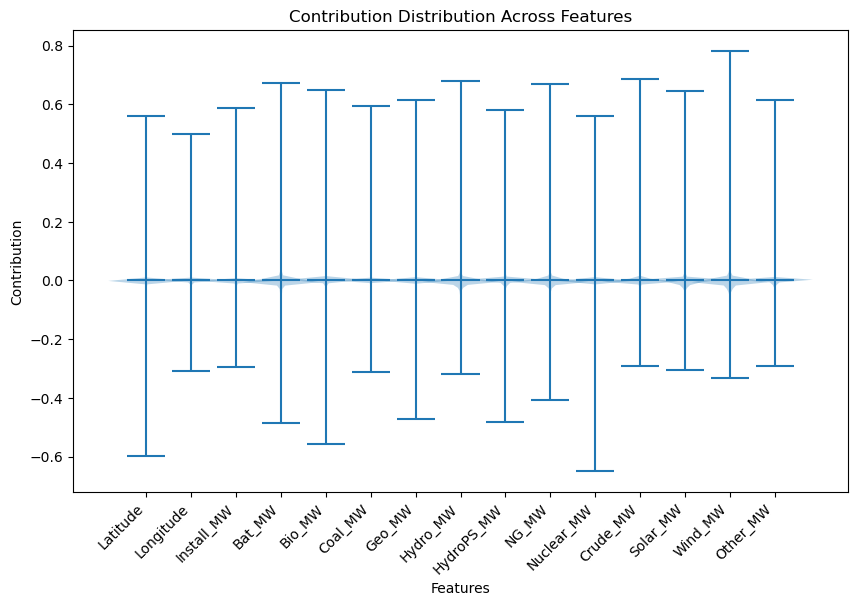

In [57]:
# Reshape contributions to combine instances and trees
combined_contributions = contributions.reshape(-1, contributions.shape[1])

# Create violin plots for each feature's contribution across instances
num_features = combined_contributions.shape[1]
fig, ax = plt.subplots(figsize=(10, 6))

ax.violinplot(combined_contributions, showmeans=False, showmedians=True, widths=1.7)
ax.set_title('Contribution Distribution Across Features')
ax.set_xlabel('Features')
ax.set_ylabel('Contribution')

# Customize x-axis ticks with feature names
ax.set_xticks(np.arange(1, num_features + 1))
ax.set_xticklabels(X.columns.to_list(),rotation=45, ha='right')

plt.show()
plt.show()

In [ ]:
from sklearn.inspection import shap

# Calculate SHAP values
explainer = shap.TreeExplainer(rf)
shap_values = explainer.shap_values(X_test)

# Summary plot
shap.summary_plot(shap_values, X_test)


# KNN

In [ ]:
from sklearn.neighbors import KNeighborsClassifier

# Initialize the KNN Classifier
knn = KNeighborsClassifier(n_neighbors=5)  # You can adjust the number of neighbors (k) as needed

# Train the model
knn.fit(X_train, y_train)

# Make predictions
y_pred_knn = knn.predict(X_test)

# Evaluate the model
accuracy_knn = accuracy_score(y_test, y_pred_knn)
print("KNN Accuracy:", accuracy_knn)

# Classification report
print("Classification Report:")
print(classification_report(y_test, y_pred_knn))


In [ ]:
# Encode class labels
label_encoder = LabelEncoder()
y_encoded = label_encoder.fit_transform(y)
y_encoded

# Pytorch

In [ ]:
import torch
from torch.utils.data import DataLoader, TensorDataset
from sklearn.model_selection import train_test_split

# Convert features and target variable to PyTorch tensors
X_tensor = torch.tensor(X_scaled, dtype=torch.float32)
y_tensor = torch.tensor(y_encoded, dtype=torch.long)

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_tensor, y_tensor, test_size=0.2, random_state=42)

# Create data loaders
train_dataset = TensorDataset(X_train, y_train)
test_dataset = TensorDataset(X_test, y_test)

batch_size = 64
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=batch_size)

In [ ]:
# Check the shapes
print("Shape of features (X_tensor):", X_tensor.shape)
print("Shape of target variable (y_tensor):", y_tensor.shape)

In [ ]:
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, TensorDataset
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score

# Assuming X_tensor and y_tensor are your torch tensors

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_tensor, y_tensor, test_size=0.2, random_state=42)

# Define the model architecture
class Model(nn.Module):
    def __init__(self, input_size, num_classes):
        super(Model, self).__init__()
        self.fc1 = nn.Linear(input_size, 64)
        self.fc2 = nn.Linear(64, 32)
        self.fc3 = nn.Linear(32, num_classes)
        self.relu = nn.ReLU()
        self.softmax = nn.Softmax(dim=1)

    def forward(self, x):
        x = self.relu(self.fc1(x))
        x = self.relu(self.fc2(x))
        x = self.fc3(x)
        return self.softmax(x)

# Initialize the model
input_size = X_train.shape[1]
num_classes = len(np.unique(y_train))
model = Model(input_size, num_classes)

# Define hyperparameters
learning_rate = 0.001
num_epochs = 20
batch_size = 128

# Define loss function
criterion = nn.CrossEntropyLoss()

# Define optimizer
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

# Create DataLoader for training
train_dataset = TensorDataset(X_train, y_train)
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

# Training loop
for epoch in range(num_epochs):
    for i, (inputs, labels) in enumerate(train_loader):
        # Forward pass
        outputs = model(inputs)
        loss = criterion(outputs, labels)
        
        # Backward pass and optimization
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        if (i+1) % 100 == 0:
            print(f'Epoch [{epoch+1}/{num_epochs}], Step [{i+1}/{len(train_loader)}], Loss: {loss.item():.4f}')

# Evaluation
with torch.no_grad():
    outputs = model(X_test)
    _, predicted = torch.max(outputs, 1)
    accuracy = accuracy_score(y_test.numpy(), predicted.numpy())
    print(f'Accuracy on test set: {accuracy:.2f}')


In [ ]:
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, TensorDataset
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score

# Assuming X_tensor and y_tensor are your torch tensors

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_tensor, y_tensor, test_size=0.2, random_state=42)

# Define the model architecture
class Model(nn.Module):
    def __init__(self, input_size, num_classes):
        super(Model, self).__init__()
        self.fc1 = nn.Linear(input_size, 64)
        self.fc2 = nn.Linear(64, 32)
        self.fc3 = nn.Linear(32, num_classes)
        self.relu = nn.ReLU()
        self.softmax = nn.Softmax(dim=1)

    def forward(self, x):
        x = self.relu(self.fc1(x))
        x = self.relu(self.fc2(x))
        x = self.fc3(x)
        return self.softmax(x)

# Initialize the model
input_size = X_train.shape[1]
num_classes = len(np.unique(y_train))
model = Model(input_size, num_classes)

# Define hyperparameters
learning_rate = 0.001
num_epochs = 20
batch_size = 128

# Define loss function
criterion = nn.CrossEntropyLoss()

# Define optimizer
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

# Create DataLoader for training
train_dataset = TensorDataset(X_train, y_train)
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

# Training loop
for epoch in range(num_epochs):
    for i, (inputs, labels) in enumerate(train_loader):
        # Forward pass
        outputs = model(inputs)
        loss = criterion(outputs, labels)
        
        # Backward pass and optimization
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        if (i+1) % 100 == 0:
            print(f'Epoch [{epoch+1}/{num_epochs}], Step [{i+1}/{len(train_loader)}], Loss: {loss.item():.4f}')

# Evaluation
with torch.no_grad():
    outputs = model(X_test)
    _, predicted = torch.max(outputs, 1)
    accuracy = accuracy_score(y_test.numpy(), predicted.numpy())
    print(f'Accuracy on test set: {accuracy:.2f}')
